<a href="https://colab.research.google.com/github/tempdeltavalue/LSTM-VAE/blob/main/lstm_vae.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# Load the Drive helper and mount
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [2]:
%cd drive/MyDrive/WeatherForecasting

/content/drive/MyDrive/WeatherForecasting


In [3]:
import pandas as pd 

import numpy as np
import tensorflow as tf

import matplotlib.pyplot as plt 

from datetime import datetime

pd.set_option('display.max_rows', 3000)
pd.set_option('display.max_columns', 3000)

df = pd.read_csv("dataset.csv") #dataset.csv
unique_wells = df["node_id"].unique()

date_time = pd.to_datetime(df['production_date'])  # https://pandas.pydata.org/docs/reference/api/pandas.to_datetime.html
timestamp_s = date_time.map(pd.Timestamp.timestamp)

day = 1
week = 7*day

# df['Day sin'] = np.sin(timestamp_s * (2 * np.pi / day))
# df['Day cos'] = np.cos(timestamp_s * (2 * np.pi / day))
# df['Week sin'] = np.sin(timestamp_s * (2 * np.pi / week))
# df['Week cos'] = np.cos(timestamp_s * (2 * np.pi / week))

# plt.plot(day_sin)
# plt.show()
# plt.plot(day_cos)
# plt.show()  

df.set_index(["node_id", "production_date"], inplace=True)

In [4]:
t_cols = list(df.columns[0:18])
p_cols = list(filter(lambda x:"alloc" in x and "+" not in x, df.columns))
pr_cols = p_cols + t_cols

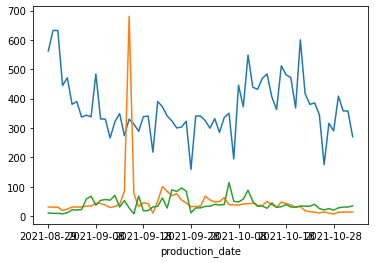

In [5]:
for p_col in p_cols:
  df.loc[unique_wells[0]][p_col].plot()

In [6]:
# test_well = df.loc[unique_wells[0]]
# time_scale_factors = [10, 50, 100]
# h_cols = []


# print(test_well.index)
# test_well = pd.melt(test_well, id_vars=test_well.index, value_vars=h_cols)

# print(test_well.head(20))

    # test_well.melt(id_vars=[h_cols])

        # for s_factor in time_scale_factors:
        #     day = 100 * s_factor
        #     day_sin = np.sin(h * (2 * np.pi / day))
        #     print(day_sin)
        #     day_cos = np.cos(timestamp_s * (2 * np.pi / day))

            # df["col_{}_h_{}_sin_{}".format(col, h, s_factor)] = day_sin
            # df["col_{}_h_{}_cos_{}".format(col, h, s_factor)] = day_cos

In [7]:
# USE RAW DATA WITHOUT TIME IN ROW 

#df = df.loc[df['node_id'] == "BOW TIE 41-44 3AH"]#[a_cols]
pd.options.display.width = None
pd.options.display.max_columns = None
pd.set_option('display.max_rows', 3000)
pd.set_option('display.max_columns', 3000)

df=(df-df.min())/(df.max()-df.min())

df.head(100) 

Frequency - Output  \
node_id             production_date                       
BOW TIE 41-44 3AH   2021-08-29                 0.166667   
                    2021-08-30                 0.166667   
                    2021-08-31                 0.166667   
                    2021-09-01                 0.166667   
                    2021-09-02                 0.166667   
                    2021-09-03                 0.166667   
                    2021-09-04                 0.166667   
                    2021-09-05                 0.166667   
                    2021-09-06                 0.166667   
                    2021-09-07                 0.166667   
                    2021-09-08                 0.166667   
                    2021-09-09                 0.166667   
                    2021-09-10                 0.166667   
                    2021-09-11                 0.166667   
                    2021-09-12                 0.166667   
                    2021-09-13                 0.166667   
                    2021-09-14                 0.166667   
                    2021-09-15                 0.166667   
                    2021-09-16                 0.166667   
                    2021-09-17                 0.166667   
                    2021-09-18                 0.166667   
                    2021-09-19                 0.166667   
                    2021-09-20                 0.166667   
                    2021-09-21                 0.166667   
                    2021-09-22                 0.166667   
                    2021-09-23                 0.166667   
                    2021-09-24                 0.166667   
                    2021-09-25                 0.166667   
                    2021-09-26                 0.166667   
                    2021-09-27                 0.166667   
                    2021-09-28                 0.166667   
                    2021-09-29                 0.166667   
                    2021-09-30                 0.166667   
                    2021-10-01                 0.166667   
                    2021-10-02                 0.166667   
                    2021-10-03                 0.166667   
                    2021-10-04                 0.166667   
                    2021-10-05                 0.166667   
                    2021-10-06                 0.166667   
                    2021-10-07                 0.166667   
                    2021-10-08                 0.166667   
                    2021-10-09                 0.166667   
                    2021-10-10                 0.166667   
                    2021-10-11                 0.166667   
                    2021-10-12                 0.166667   
                    2021-10-13                 0.166667   
                    2021-10-14                 0.166667   
                    2021-10-15                 0.166667   
                    2021-10-16                 0.166667   
                    2021-10-17                 0.166667   
                    2021-10-18                 0.166667   
                    2021-10-19                 0.166667   
                    2021-10-20                 0.166667   
                    2021-10-21                 0.166667   
                    2021-10-22                 0.166667   
                    2021-10-23                 0.166667   
                    2021-10-24                 0.166667   
                    2021-10-25                 0.166667   
                    2021-10-26                 0.166667   
                    2021-10-27                 0.166667   
                    2021-10-28                 0.166667   
                    2021-10-29                 0.166667   
                    2021-10-30                 0.166667   
                    2021-10-31                 0.166667   
                    2021-11-01                 0.166667   
CHIEF 33-28 4AH     2021-10-03                 0.166667   
                    2021-

In [8]:
train_df = {}
val_df = {}
# t_cols += ["Day sin", "Day cos", "Week sin", "Week cos"]
all_df = {}

print(len(pr_cols))
for t_well_name in unique_wells:
    test_well = df.loc[t_well_name][pr_cols]
    n = len(test_well)
    train_df[t_well_name] = test_well[0:int(n*0.7)]
    val_df[t_well_name] = test_well[int(n*0.7):]
    all_df[t_well_name] = test_well[0:n]

21


In [9]:
len(t_cols)

18

In [10]:
def get_tf_dataset(df):
    features = df[t_cols]
    targets = df[p_cols]

    features.head()
    features = tf.convert_to_tensor(features)
    targets = tf.convert_to_tensor(targets)

    dataset = tf.data.Dataset.from_tensor_slices((features, targets))
    dataset = dataset.window(5, shift=1, drop_remainder=True)#.batch(5)

    dataset = dataset.flat_map(lambda x, y: tf.data.Dataset.zip((x.batch(3), y.batch(3))))
    dataset = dataset.shuffle(buffer_size=1000)

    return dataset

dataset = get_tf_dataset(df)
for x, y in dataset:
  print(x.numpy())
  print(y.numpy())


# print(features)


Streaming output truncated to the last 5000 lines.
  0.4084507  0.8        0.1787037  0.46025384 0.42559524 0.82608696
  0.04460338 0.07086384 0.40540541 0.56813419 0.41864202 0.18482168]
 [0.66666667 0.33333333 0.56550952 0.36842105 0.86153846 0.82051282
  0.4084507  0.8        0.17808642 0.46158985 0.42559524 0.82608696
  0.04460338 0.07027818 0.36486486 0.56813419 0.41864202 0.18426873]]
[[0.07965468 0.30884814 0.26981477]
 [0.08118702 0.3096031  0.28279   ]
 [0.07272861 0.30582534 0.26607392]]
[[0.66666667 0.33333333 0.49384099 0.27631579 0.         0.81538462
  0.30985915 0.79393939 0.1691358  0.30794923 0.38392857 0.80745342
  0.04564369 0.05710102 0.43243243 0.46540879 0.40056247 0.17500691]
 [0.66666667 0.33333333 0.4893617  0.27631579 0.         0.81538462
  0.30985915 0.8        0.16975309 0.29859719 0.38095238 0.80745342
  0.04720416 0.05739385 0.45945946 0.4612159  0.40297308 0.17555986]
 [0.66666667 0.33333333 0.49160134 0.27631579 0.         0.81538462
  0.30985915 0.7939

In [19]:
import random

class DataGenerator(tf.keras.utils.Sequence):
    def __init__(self, 
                 train_dict,
                 feature_columns, 
                 prediction_columns,
                 input_seq_len,
                 shift,
                 output_len,
                 pred_measurement_name=None,
                 batch_size=8
                 ):
        
        self.input_seq_len = input_seq_len
        self.shift = shift # step in future 
        self.output_len = output_len #
        
        self.batch_size = batch_size
        
        #data_frame = (data_frame - data_frame.mean()) / data_frame.std()
#         data_frame = (data_frame - data_frame.min()) / (data_frame.max() - data_frame.min())
        
        self.seq_x = []
        self.seq_y = []

        self.batch_x_dict = {}
        self.batch_y_dict = {}

        # used for training 
        self.total_batch_x_arr = []
        self.total_batch_y_arr = []

        for key, value in train_dict.items():
            features = value[feature_columns]
            labels = value[pred_measurement_name]
            
            batch_count = int((len(features) - self.input_seq_len - self.output_len) / batch_size)

            if batch_count <= 0:
              continue

            self.batch_x_dict[key] = np.empty((batch_count, batch_size, self.input_seq_len, len(feature_columns)))
            self.batch_y_dict[key] = np.empty((batch_count, batch_size, self.output_len, 1))

            for b_i in range(batch_count):
                batch_arr_x = np.empty((batch_size, self.input_seq_len, len(feature_columns)))
                batch_arr_y = np.empty((batch_size, self.output_len, 1))

                for item_b_i in range(batch_size):
                    start_ind = item_b_i + (b_i * batch_size)
                    y_start_ind = start_ind #+ self.input_seq_len + self.shift  # shift here ! UPDATE UPDATE UPDATE

                    batch_arr_x[item_b_i] = features[start_ind:start_ind+self.input_seq_len].to_numpy()
                    batch_arr_y[item_b_i] = labels[y_start_ind:y_start_ind+self.output_len].to_numpy().reshape(self.output_len, 1)

                self.total_batch_x_arr.append(batch_arr_x)
                self.total_batch_y_arr.append(batch_arr_y)

                self.batch_x_dict[key][b_i] = batch_arr_x
                self.batch_y_dict[key][b_i] = batch_arr_y


        # print("\n \n SHUFFLE \n \n")
        c = list(zip(self.total_batch_x_arr, self.total_batch_y_arr))

        random.shuffle(c)

        self.total_batch_x_arr, self.total_batch_y_arr = zip(*c)

    
    def get_batch_items(self, well_name):
        return self.batch_x_dict[well_name], self.batch_y_dict[well_name]
    
    def __len__(self):
        return len(self.total_batch_x_arr)
    
    def __getitem__(self, index):
        return self.total_batch_x_arr[index], self.total_batch_y_arr[index]


In [20]:
seq_len = 6   
#'alloc_water_vol', 'alloc_gas_vol', 'alloc_oil_vol'

val_data_generator = DataGenerator(train_df, 
                                t_cols, 
                                pr_cols, 
                                seq_len,
                                shift=1, 
                                output_len=6,
                                pred_measurement_name="alloc_oil_vol")

In [ ]:
# dataset = get_tf_dataset(train_df)

BOW TIE 41-44 3AH
(8, 6, 1)


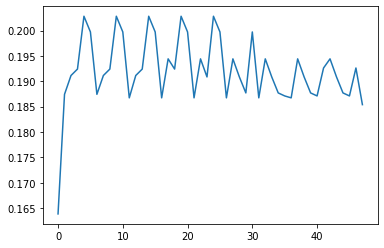

(8, 6, 1)


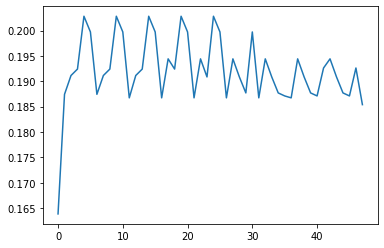

In [21]:
print(unique_wells[0])

batch_x, batch_y = val_data_generator[500]

print(batch_y.shape)
plt.plot(batch_y.reshape((batch_y.shape[0] * batch_y.shape[1])))
plt.show()

batch_x, batch_y = val_data_generator[500]

# plt.show()
print(batch_y.shape)
plt.plot(batch_y.flatten())
plt.show()

In [ ]:
print(unique_wells[0])
# batch_x, batch_y = val_data_generator.get_batch_items(unique_wells[0])

batch_x, batch_y = val_data_generator[0]

# print(batch_y.shape)
# fig = plt.gcf()
# fig.set_size_inches(16, 8)

# print(len(train_df[unique_wells[0]]["alloc_oil_vol"]))
# plt.plot(train_df[unique_wells[0]]["alloc_oil_vol"])
# plt.show()
# print(batch_y.shape)
plt.plot(batch_y.reshape((batch_y.shape[0] * batch_y.shape[1] * batch_y.shape[2])))
plt.show()

In [ ]:
BASE_SAVE_FOLDER = "prod_results_diff"

def train(model, 
          loss_fn, 
          train_data_generator, 
          val_data_generator,
          train_summary_writer,
          val_summary_writer,
          exp_name,
          epochs=20):
  
    patience = 10
    wait = 0
    best = 0
  
    batch_size = 32 # TO DO move to window generator
    optimizer = tf.optimizers.Adam()

    for epoch in range(epochs):
        total_train_loss = 0
        for step, (x_batch_train, y_batch_train) in enumerate(train_data_generator):
            
            with tf.GradientTape() as tape:
                logits = model(x_batch_train, training=True)  # Logits for this minibatch
                loss_value = loss_fn(y_batch_train, logits)
                total_train_loss += loss_value 
            
            print("\n loss_value", loss_value)
            grads = tape.gradient(loss_value, model.trainable_weights)

            optimizer.apply_gradients(zip(grads, model.trainable_weights))
                
            if step % 100 == 0:
                print(loss_value)
                print(
                    "Training loss (for one batch) at step %d: %.4f"
                    % (step, float(loss_value))
                )
                print("Seen so far: %s samples" % ((step + 1) * batch_size))

        print("before summary wr")
        with train_summary_writer.as_default():
            av_train_loss = total_train_loss/len(train_data_generator)
            tf.summary.scalar('loss', av_train_loss, step=epoch)
            print("END OF EPOCH LOSS VALUE %.6f at epoch %d", av_train_loss, epoch)
        
        # VALIDATION !
        total_val_loss = 0
        for x_batch_val, y_batch_val in val_data_generator: 
            val_logits = model(x_batch_val, training=False)
            total_val_loss += loss_fn(y_batch_val, val_logits)

        with val_summary_writer.as_default():
            av_val_loss = total_val_loss/len(val_data_generator)
            tf.summary.scalar('val_loss', av_val_loss, step=epoch)
            print("END OF EPOCH VAL LOSS VALUE %.6f at epoch %d", av_val_loss, epoch)


        wait += 1

        if best == 0:
          best = av_val_loss

        if av_val_loss < best:
           best = av_val_loss
           wait = 0
           model.save("{}/weights/{}/train_loss_{}_val_loss{}".format(BASE_SAVE_FOLDER, exp_name, av_train_loss, av_val_loss))

        if wait >= patience:
          break

In [ ]:
import tensorflow as tf
from keras.regularizers import l2
from tensorflow.keras.layers import LSTM, Bidirectional, Dense, Reshape

def get_lstm_model(output_steps, num_features = 1):
    multi_lstm_model = tf.keras.Sequential([
        # Shape [batch, time, features] => [batch, lstm_units].
        # Adding more `lstm_units` just overfits more quickly.
        tf.keras.layers.LSTM(32, return_sequences=False, kernel_regularizer=l2()),
        # Shape => [batch, out_steps*features].
        tf.keras.layers.Dense(output_steps*num_features,
                              kernel_initializer=tf.initializers.GlorotUniform()),
        # Shape => [batch, out_steps, features].
        tf.keras.layers.Reshape([output_steps, num_features])
    ])

    return multi_lstm_model

def get_bi_lstm_model(output_steps, num_features = 1):
    multi_lstm_model = tf.keras.Sequential([
        # Shape [batch, time, features] => [batch, lstm_units].
        # Adding more `lstm_units` just overfits more quickly.
        Bidirectional(LSTM(32, return_sequences=False, kernel_regularizer=l2())),
        # Shape => [batch, out_steps*features].
        Dense(output_steps*num_features,
                              kernel_initializer=tf.initializers.GlorotUniform()),
        # Shape => [batch, out_steps, features].
        Reshape([output_steps, num_features])
    ])

    return multi_lstm_model


def get_large_lstm_model(output_steps, num_features = 1):
    multi_lstm_model = tf.keras.Sequential([
        # Shape [batch, time, features] => [batch, lstm_units].
        # Adding more `lstm_units` just overfits more quickly.
        tf.keras.layers.LSTM(128, return_sequences=True),
        tf.keras.layers.LSTM(128, return_sequences=True),
        # tf.keras.layers.Dropout(0.2),
        tf.keras.layers.LSTM(128, return_sequences=False),

        # Shape => [batch, out_steps*features].
        tf.keras.layers.Dense(output_steps*num_features,
                              kernel_initializer=tf.initializers.zeros()),
        # Shape => [batch, out_steps, features].
        tf.keras.layers.Reshape([output_steps, num_features])
    ])

    return multi_lstm_model

In [ ]:
import datetime


def create_summary_writer(exp_name, path="{}/".format(BASE_SAVE_FOLDER)):
    log_dir = path + exp_name
    train_summary_writer = tf.summary.create_file_writer(log_dir + "/train")
    val_summary_writer = tf.summary.create_file_writer(log_dir + "/validation")
    return train_summary_writer, val_summary_writer


class ExpConfig:
  def __init__(self, name, model, input_count, output_count, lbl_name):
    self.name=name
    self.model=model
    self.input_count=input_count
    self.output_count=output_count
    self.lbl_name = lbl_name


#'alloc_water_vol', 'alloc_gas_vol', 'alloc_oil_vol'

train_models = [   
    # ExpConfig("bilstmtkerregshufle_hourly", get_bi_lstm_model(output_steps=1), 7, 1, lbl_name='alloc_water_vol'),
    # ExpConfig("bilstmtkerregshufle__hourly", get_bi_lstm_model(output_steps=1), 7, 1, lbl_name='alloc_gas_vol'),
    ExpConfig("temp77_", get_bi_lstm_model(output_steps=7), 7, 7, lbl_name='alloc_oil_vol'),

    # ExpConfig("largelstmshufle__hourly", get_large_lstm_model(output_steps=1), 7, 1, lbl_name='alloc_water_vol'),     
    # ExpConfig("largelstmshufle__hourly", get_large_lstm_model(output_steps=1), 7, 1, lbl_name='alloc_gas_vol'),     
    # ExpConfig("largelstmshufle__hourly", get_large_lstm_model(output_steps=1), 7, 1, lbl_name='alloc_oil_vol'),       
]

for config in train_models:
    exp_name = config.name + "{}_{}_{}".format(config.input_count, 
                                               config.output_count, 
                                               config.lbl_name)
    print("\n \n \n exp_name", exp_name)

    summary_writer, val_summary_writer = create_summary_writer(exp_name=exp_name)

    train_data_generator = DataGenerator(train_df, 
                                         t_cols,
                                         p_cols,
                                         config.input_count, 
                                         shift=0, 
                                         output_len=config.output_count,
                                         pred_measurement_name=config.lbl_name)
        
    val_data_generator = DataGenerator(val_df, 
                                       t_cols, 
                                       p_cols, 
                                       config.input_count,
                                       shift=0, 
                                       output_len=config.output_count,
                                       pred_measurement_name=config.lbl_name)

    train(config.model, 
          tf.losses.MeanSquaredError(), 
          train_data_generator, 
          val_data_generator,
          summary_writer,
          val_summary_writer,
          exp_name=exp_name,
          epochs=10)


 
 
 exp_name temp77_7_7_alloc_oil_vol


KeyboardInterrupt: ignored

In [ ]:
%load_ext tensorboard

In [ ]:
!kill 308

In [ ]:
%tensorboard --logdir prod_results_diff

<IPython.core.display.Javascript object>

In [ ]:
import matplotlib.pyplot as plt 
import os 
import glob
import re

#'alloc_water_vol', 'alloc_gas_vol', 'alloc_oil_vol'

def get_top_N_argmax(arr, n):
    arr = arr.argsort()
    pos_corr = arr[-n:]
    neg_corr = arr[:n]

    return pos_corr, neg_corr

def analyze(in_count, out_count, model, lbl_name, batch_x, batch_y, w_path=None):
    y_lbls = []
    a_preds = []
    x_l = []

    grad_df = pd.DataFrame(columns = ["index", "grad_value"] + t_cols)
    grad_list = []
    for step, (x_batch_train, y_batch_train) in enumerate(zip(batch_x, batch_y)):
        x_l.append(x_batch_train.reshape(x_batch_train.shape[0] * x_batch_train.shape[1], x_batch_train.shape[2]))

        with tf.GradientTape() as tape:
          x_batch_tf = tf.Variable(x_batch_train, dtype=tf.float32)
          preds = model(x_batch_tf, training=True)  # Logits for this minibatch
        grads = tape.gradient(preds, x_batch_tf)
        
        grads = tf.reduce_mean(grads, axis=1).numpy()[0]

        grad_list.append(grads)

        # plt.show()

        # plt.bar(range(len(pos_corr)), pos_corr, color='royalblue', alpha=0.7)


        # print("\n")
        # print(step, grads.argmax(), t_cols[grads.argmax()])
        # print(step, grads.argmin(), t_cols[grads.argmin()])

        a_preds.append(preds.numpy().reshape(8))
        y_lbls.append(y_batch_train.reshape(8))

    grad_df.set_index("index", inplace=True)
    # grad_df = grad_df.groupby("index")
    return y_lbls, a_preds, x_l, grad_list

In [ ]:
def flatten(t):
    return [item for sublist in t for item in sublist]

def get_min_val_w_path(w_path):
    all_w_paths = glob.glob(os.path.join(w_path, '*'))
    mapped_array = list(map(lambda x: re.split("/ |_", x), all_w_paths))
    a_min = min(i for index, i in enumerate(mapped_array))
    w_path = list(filter(lambda x: a_min[-1] in x, all_w_paths))

    return w_path[0]

base_weights_path = BASE_SAVE_FOLDER + "/weights"
w_paths = glob.glob(os.path.join(base_weights_path, "*"))
    
for w_path in w_paths:
    w_exp_name = w_path.split("/")[-1]
    model_name, in_count, out_count, lbl_name1, lbl_name2, lbl_name3 = w_exp_name.split("_") 
    total_lbl_name = '_'.join([lbl_name1, lbl_name2, lbl_name3])

    if "hourly" not in model_name:
      continue

    if "bi" not in model_name:
      continue

    val_data_generator = DataGenerator(all_df, 
                                    t_cols, 
                                    p_cols, 
                                    int(in_count),
                                    shift=0, 
                                    output_len=int(out_count),
                                    pred_measurement_name=total_lbl_name)
    
    if "large" in model_name:
      model = get_large_lstm_model(output_steps=int(out_count))
    elif "bi" in model_name:
      model = get_bi_lstm_model(output_steps=int(out_count))
    else:
      model = get_lstm_model(output_steps=int(out_count))


    min_val_loss_w_path = get_min_val_w_path(w_path)
    model.load_weights(min_val_loss_w_path)


    for well_name in unique_wells:
        print("\n \n ", model_name, total_lbl_name, well_name)

        try:
          batch_x, batch_y = val_data_generator.get_batch_items(well_name)
        except Exception as e:
          print("ERROR", well_name)
          continue


        y_lbls, a_preds, x_l, grad_list = analyze(int(in_count), int(out_count), model, total_lbl_name, batch_x, batch_y, w_path)
        
        # df.loc[well_name][p_cols].plot()
        # plt.show()

        if int(out_count) == 1:
            fig = plt.gcf()
            fig.set_size_inches(16, 8)

            res = flatten(a_preds)
            res1 = flatten(y_lbls)

            # plt.title("Predictions")
            plt.figure(figsize=(30,7), dpi=80)
            plt.plot(res)
            plt.plot(res1)
            plt.show()

            # print(t_cols)
            train_df[well_name][t_cols].plot(figsize=(30,7))
            plt.show()

            plt.figure(figsize=(30,7), dpi=80)
            plt.plot(grad_list)
            # plt.legend(t_cols)
            plt.show()

NameError: ignored

In [89]:
val_data_generator = DataGenerator(all_df, 
                                t_cols, 
                                p_cols, 
                                5,
                                shift=0, 
                                output_len=5,
                                pred_measurement_name="alloc_oil_vol")

In [97]:
from tensorflow.keras.layers import Input, LSTM, Dense, Lambda, RepeatVector, Reshape, Normalization, Input, Bidirectional
from tensorflow.keras.models import Model 
import tensorflow as tf
from tensorflow import keras
import keras.backend as K

# https://github.com/bilalmirza8519/LSTM-VAE/blob/master/LSTM-VAE.py
# https://learnopencv.com/variational-autoencoder-in-tensorflow/

class Sampling(tf.keras.layers.Layer):

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon


class Encoder(tf.keras.layers.Layer):

    def __init__(self, seq_len=7, name="encoder", **kwargs):
        super(Encoder, self).__init__(name=name, **kwargs)

        self.lstm_1 = LSTM(seq_len, return_sequences=False)
        self.dense_mean = Dense(18, activation="sigmoid")
        self.dense_var = Dense(18, activation="sigmoid")
        self.sampling = Sampling()
        # self.lambda_l = Lambda(lambda x: K.l2_normalize(x))


    def call(self, inputs):
        x = self.lstm_1(inputs)
        mean = self.dense_mean(x)
        var = self.dense_var(x)
        z = self.sampling((mean, var))
        # z = self.lambda_l(x)
        z = tf.math.sigmoid(z)

        return mean, var, z

class Decoder(tf.keras.layers.Layer):

    def __init__(self, seq_len, features_n, intermediate_dim=64, name="decoder", **kwargs):

        super(Decoder, self).__init__(name=name, **kwargs)
        self.repeat = RepeatVector(seq_len)
        self.lstm_1 = LSTM(intermediate_dim, return_sequences=False)

        self.dense = Dense(seq_len*features_n,
                      kernel_initializer=tf.initializers.GlorotUniform())
        
        self.reshape = Reshape([seq_len, features_n])

        # self.lambda_l = Lambda(lambda x: K.l2_normalize(x))

    def call(self, inputs):
        x = self.repeat(inputs)
        x = self.lstm_1(x)
        x = self.dense(x)
        x = self.reshape(x)
        # x = self.lambda_l(x)

        return x


class LSTMVAE(tf.keras.Model):

    def __init__(self, seq_len, features_n, intermediate_dim):
        super(LSTMVAE, self).__init__()
        self.seq_len = seq_len
        self.features_n = features_n
        self.kl_loss = 0 

        self.encoder = Encoder(seq_len)

        self.decoder = Decoder(seq_len, 1)

    def call(self, inputs):
        mean, var, z  = self.encoder(inputs)
        reconstructed = self.decoder(z)

        self.kl_loss = -0.5 * tf.reduce_mean(
            var - tf.square(mean) - tf.exp(var) + 1
        )
        
        self.add_loss(self.kl_loss)

        return reconstructed

def simpleAE(output_steps, num_features = 1):
    multi_lstm_model = tf.keras.Sequential([
        # Shape [batch, time, features] => [batch, lstm_units].
        # Adding more `lstm_units` just overfits more quickly.
        # LSTM(64, name='EncoderLSTM', return_sequences=True), # intermediate dimension
        LSTM(len(t_cols),name='EncoderLSTM', return_sequences=True),#input_dim
        # tf.keras.layers.Dropout(0.2),
        # decoded = RepeatVector(self.seq_len, name='EmbeddingtoTimeSeries')(inputs) #timesteps
        LSTM(64 ,name='DecoderLSTM1', return_sequences=False),
        Dense(output_steps*num_features,
                              kernel_initializer=tf.initializers.GlorotUniform()),
        # Shape => [batch, out_steps, features].
        Reshape([output_steps, num_features])
    ])

    return multi_lstm_model

# dec_model = decoder((1, 18))
model = LSTMVAE(seq_len=5, features_n=len(t_cols), intermediate_dim=128)
print(val_data_generator[0][0].shape)
mean, var, z = model.layers[0](val_data_generator[0][0])
preds = model(val_data_generator[0][0])
print(preds.shape)
# model.summary()

(8, 5, 18)
(8, 5, 1)


In [102]:
BASE_SAVE_FOLDER = "vae_results"

def train2(model, 
          loss_fn, 
          train_data_generator, 
          val_data_generator,
          train_summary_writer,
          val_summary_writer,
          exp_name,
          epochs=20):
  
    patience = 10
    wait = 0
    best = 0
  
    batch_size = 32 # TO DO move to window generator
    optimizer = tf.optimizers.Adam()

    for epoch in range(epochs):
        total_train_loss = 0
        total_kl_loss = 0
        for step, (x_batch_train, y_batch_train) in enumerate(train_data_generator):
            
            with tf.GradientTape() as tape:
                logits = model(x_batch_train, training=True)  # Logits for this minibatch
                mse = loss_fn(y_batch_train, logits)
                loss_value = mse + sum(model.losses)
                total_train_loss += loss_value 
                total_kl_loss += sum(model.losses)
            
            grads = tape.gradient(loss_value, model.trainable_weights)

            optimizer.apply_gradients(zip(grads, model.trainable_weights))
                
            if step % 100 == 0:
                print("mse", mse)
                print("kl loss", model.kl_loss)
                print("total", loss_value)

                print(
                    "Training loss (for one batch) at step %d: %.4f"
                    % (step, float(loss_value))
                )
                print("Seen so far: %s samples" % ((step + 1) * batch_size))

        print("before summary wr")
        with train_summary_writer.as_default():
            av_train_loss = total_train_loss/len(train_data_generator)
            tf.summary.scalar('loss', av_train_loss, step=epoch)
            tf.summary.scalar('kl_loss', total_kl_loss/len(train_data_generator), step=epoch)

            print("END OF EPOCH LOSS VALUE %.6f at epoch %d", av_train_loss, epoch)
        
        # VALIDATION !
        total_val_loss = 0
        total_val_kl_loss = 0

        for x_batch_val, y_batch_val in val_data_generator: 
            val_logits = model(x_batch_val, training=False)
            total_val_loss += loss_fn(y_batch_val, val_logits) + sum(model.losses)
            total_val_kl_loss += sum(model.losses)

        with val_summary_writer.as_default():
            av_val_loss = total_val_loss/len(val_data_generator)
            tf.summary.scalar('val_loss', av_val_loss, step=epoch)
            tf.summary.scalar('val_kl_loss', total_val_kl_loss/len(val_data_generator), step=epoch)

            print("END OF EPOCH VAL LOSS VALUE %.6f at epoch %d", av_val_loss, epoch)


        wait += 1

        if best == 0:
          best = av_val_loss

        if av_val_loss < best:
           best = av_val_loss
           wait = 0
           model.save(f"{BASE_SAVE_FOLDER}/weights/{exp_name}/train_loss_{av_train_loss:.3f}_val_loss_{av_val_loss:.3f}")

        if wait >= patience:
          break

In [121]:
import datetime

def create_summary_writer(exp_name, path="{}/".format(BASE_SAVE_FOLDER)):
    log_dir = path + exp_name
    train_summary_writer = tf.summary.create_file_writer(log_dir + "/train")
    val_summary_writer = tf.summary.create_file_writer(log_dir + "/validation")
    return train_summary_writer, val_summary_writer


class ExpConfig:
  def __init__(self, name, model, input_count, output_count, lbl_name):
    self.name=name
    self.model=model
    self.input_count=input_count
    self.output_count=output_count
    self.lbl_name = lbl_name


#'alloc_water_vol', 'alloc_gas_vol', 'alloc_oil_vol'

# model2 =
simpleAEm = simpleAE(output_steps=7)

train_models = [   
    # ExpConfig("BI_TEMP_", get_bi_lstm_model(output_steps=7), 7, 7, lbl_name='alloc_oil_vol'),
    ExpConfig("BIG_TRY_",  LSTMVAE(seq_len=7, features_n=len(t_cols), intermediate_dim=128), 
              7, 7, lbl_name='alloc_oil_vol'),    
              
    ExpConfig("BIG_TRY_",  LSTMVAE(seq_len=5, features_n=len(t_cols), intermediate_dim=128),
              5, 5, lbl_name='alloc_oil_vol'),    
    # ExpConfig("lstm_", simpleAE(output_steps=40), 40, 40, lbl_name='alloc_oil_vol'),    
   
]
    

for config in train_models:
    exp_name = config.name + "{}_{}_{}".format(config.input_count, 
                                               config.output_count, 
                                               config.lbl_name)
    print("\n \n \n exp_name", exp_name)

    summary_writer, val_summary_writer = create_summary_writer(exp_name=exp_name)

    train_data_generator = DataGenerator(train_df, 
                                         t_cols,
                                         p_cols,
                                         config.input_count, 
                                         shift=0, 
                                         output_len=config.output_count,
                                         pred_measurement_name=config.lbl_name, batch_size=8)
        
    val_data_generator = DataGenerator(val_df, 
                                       t_cols, 
                                       p_cols, 
                                       config.input_count,
                                       shift=0, 
                                       output_len=config.output_count,
                                       pred_measurement_name=config.lbl_name, batch_size=8)

    train2(config.model, 
          tf.losses.MeanSquaredError(), 
          train_data_generator, 
          val_data_generator,
          summary_writer,
          val_summary_writer,
          exp_name=exp_name,
          epochs=20)


 
 
 exp_name BIG_TRY_7_7_alloc_oil_vol
mse tf.Tensor(0.07737758, shape=(), dtype=float32)
kl loss tf.Tensor(0.211738, shape=(), dtype=float32)
total tf.Tensor(0.28911558, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.2891
Seen so far: 32 samples
mse tf.Tensor(0.01998462, shape=(), dtype=float32)
kl loss tf.Tensor(0.11659571, shape=(), dtype=float32)
total tf.Tensor(0.13658033, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.1366
Seen so far: 3232 samples
mse tf.Tensor(0.013185272, shape=(), dtype=float32)
kl loss tf.Tensor(0.03850491, shape=(), dtype=float32)
total tf.Tensor(0.051690184, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0517
Seen so far: 6432 samples
mse tf.Tensor(0.013331151, shape=(), dtype=float32)
kl loss tf.Tensor(0.015665011, shape=(), dtype=float32)
total tf.Tensor(0.028996162, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0290
Seen so far: 9632 samples
mse tf.Tensor(0.0022

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_7_7_alloc_oil_vol/train_loss_0.025_val_loss_0.018/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_7_7_alloc_oil_vol/train_loss_0.025_val_loss_0.018/assets


mse tf.Tensor(0.016901901, shape=(), dtype=float32)
kl loss tf.Tensor(0.0012427974, shape=(), dtype=float32)
total tf.Tensor(0.018144699, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0181
Seen so far: 32 samples
mse tf.Tensor(0.010603735, shape=(), dtype=float32)
kl loss tf.Tensor(0.0010790634, shape=(), dtype=float32)
total tf.Tensor(0.011682799, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0117
Seen so far: 3232 samples
mse tf.Tensor(0.007665035, shape=(), dtype=float32)
kl loss tf.Tensor(0.0009785816, shape=(), dtype=float32)
total tf.Tensor(0.008643616, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0086
Seen so far: 6432 samples
mse tf.Tensor(0.02339114, shape=(), dtype=float32)
kl loss tf.Tensor(0.0008190572, shape=(), dtype=float32)
total tf.Tensor(0.024210198, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0242
Seen so far: 9632 samples
mse tf.Tensor(0.0009083088, shape=(), dtype=float

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_7_7_alloc_oil_vol/train_loss_0.023_val_loss_0.018/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_7_7_alloc_oil_vol/train_loss_0.023_val_loss_0.018/assets


mse tf.Tensor(0.016488153, shape=(), dtype=float32)
kl loss tf.Tensor(0.0005826971, shape=(), dtype=float32)
total tf.Tensor(0.01707085, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0171
Seen so far: 32 samples
mse tf.Tensor(0.010147721, shape=(), dtype=float32)
kl loss tf.Tensor(0.0005266629, shape=(), dtype=float32)
total tf.Tensor(0.0106743835, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0107
Seen so far: 3232 samples
mse tf.Tensor(0.0076424857, shape=(), dtype=float32)
kl loss tf.Tensor(0.0004937516, shape=(), dtype=float32)
total tf.Tensor(0.008136237, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0081
Seen so far: 6432 samples
mse tf.Tensor(0.023955984, shape=(), dtype=float32)
kl loss tf.Tensor(0.00042744435, shape=(), dtype=float32)
total tf.Tensor(0.024383428, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0244
Seen so far: 9632 samples
mse tf.Tensor(0.00065983593, shape=(), dtype=f

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_7_7_alloc_oil_vol/train_loss_0.023_val_loss_0.018/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_7_7_alloc_oil_vol/train_loss_0.023_val_loss_0.018/assets


mse tf.Tensor(0.016453955, shape=(), dtype=float32)
kl loss tf.Tensor(0.00032799982, shape=(), dtype=float32)
total tf.Tensor(0.016781956, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0168
Seen so far: 32 samples
mse tf.Tensor(0.01054122, shape=(), dtype=float32)
kl loss tf.Tensor(0.00030210655, shape=(), dtype=float32)
total tf.Tensor(0.010843326, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0108
Seen so far: 3232 samples
mse tf.Tensor(0.0084647825, shape=(), dtype=float32)
kl loss tf.Tensor(0.0002878656, shape=(), dtype=float32)
total tf.Tensor(0.008752648, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0088
Seen so far: 6432 samples
mse tf.Tensor(0.023148267, shape=(), dtype=float32)
kl loss tf.Tensor(0.00025373365, shape=(), dtype=float32)
total tf.Tensor(0.023402, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0234
Seen so far: 9632 samples
mse tf.Tensor(0.000702609, shape=(), dtype=float

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_7_7_alloc_oil_vol/train_loss_0.022_val_loss_0.018/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_7_7_alloc_oil_vol/train_loss_0.022_val_loss_0.018/assets


mse tf.Tensor(0.0176296, shape=(), dtype=float32)
kl loss tf.Tensor(0.0001325272, shape=(), dtype=float32)
total tf.Tensor(0.017762126, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0178
Seen so far: 32 samples
mse tf.Tensor(0.010063678, shape=(), dtype=float32)
kl loss tf.Tensor(0.00012423802, shape=(), dtype=float32)
total tf.Tensor(0.010187916, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0102
Seen so far: 3232 samples
mse tf.Tensor(0.00928446, shape=(), dtype=float32)
kl loss tf.Tensor(0.00012007397, shape=(), dtype=float32)
total tf.Tensor(0.009404534, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0094
Seen so far: 6432 samples
mse tf.Tensor(0.024166653, shape=(), dtype=float32)
kl loss tf.Tensor(0.00010778589, shape=(), dtype=float32)
total tf.Tensor(0.024274439, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0243
Seen so far: 9632 samples
mse tf.Tensor(0.00075270544, shape=(), dtype=flo

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.026_val_loss_0.019/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.026_val_loss_0.019/assets


mse tf.Tensor(0.02637726, shape=(), dtype=float32)
kl loss tf.Tensor(0.0016123703, shape=(), dtype=float32)
total tf.Tensor(0.027989632, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0280
Seen so far: 32 samples
mse tf.Tensor(0.00020294602, shape=(), dtype=float32)
kl loss tf.Tensor(0.0013440992, shape=(), dtype=float32)
total tf.Tensor(0.0015470452, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0015
Seen so far: 3232 samples
mse tf.Tensor(0.0008459432, shape=(), dtype=float32)
kl loss tf.Tensor(0.0012188181, shape=(), dtype=float32)
total tf.Tensor(0.0020647612, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0021
Seen so far: 6432 samples
mse tf.Tensor(0.05597945, shape=(), dtype=float32)
kl loss tf.Tensor(0.0010888879, shape=(), dtype=float32)
total tf.Tensor(0.057068337, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0571
Seen so far: 9632 samples
mse tf.Tensor(0.012664792, shape=(), dtype=fl

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.024_val_loss_0.018/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.024_val_loss_0.018/assets


mse tf.Tensor(0.025214741, shape=(), dtype=float32)
kl loss tf.Tensor(0.00074871466, shape=(), dtype=float32)
total tf.Tensor(0.025963455, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0260
Seen so far: 32 samples
mse tf.Tensor(0.00011248991, shape=(), dtype=float32)
kl loss tf.Tensor(0.00065086246, shape=(), dtype=float32)
total tf.Tensor(0.0007633524, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0008
Seen so far: 3232 samples
mse tf.Tensor(0.0008772807, shape=(), dtype=float32)
kl loss tf.Tensor(0.0006089728, shape=(), dtype=float32)
total tf.Tensor(0.0014862535, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0015
Seen so far: 6432 samples
mse tf.Tensor(0.058386564, shape=(), dtype=float32)
kl loss tf.Tensor(0.00056000426, shape=(), dtype=float32)
total tf.Tensor(0.05894657, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0589
Seen so far: 9632 samples
mse tf.Tensor(0.013232475, shape=(), dtyp

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.023_val_loss_0.018/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.023_val_loss_0.018/assets


mse tf.Tensor(0.0262137, shape=(), dtype=float32)
kl loss tf.Tensor(0.00041734386, shape=(), dtype=float32)
total tf.Tensor(0.026631044, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0266
Seen so far: 32 samples
mse tf.Tensor(0.00010596165, shape=(), dtype=float32)
kl loss tf.Tensor(0.0003704255, shape=(), dtype=float32)
total tf.Tensor(0.00047638715, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0005
Seen so far: 3232 samples
mse tf.Tensor(0.0009637041, shape=(), dtype=float32)
kl loss tf.Tensor(0.000351852, shape=(), dtype=float32)
total tf.Tensor(0.0013155561, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0013
Seen so far: 6432 samples
mse tf.Tensor(0.061483376, shape=(), dtype=float32)
kl loss tf.Tensor(0.00032825643, shape=(), dtype=float32)
total tf.Tensor(0.061811633, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0618
Seen so far: 9632 samples
mse tf.Tensor(0.013548394, shape=(), dtype=

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.023_val_loss_0.018/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.023_val_loss_0.018/assets


mse tf.Tensor(0.026379803, shape=(), dtype=float32)
kl loss tf.Tensor(0.00025548248, shape=(), dtype=float32)
total tf.Tensor(0.026635285, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0266
Seen so far: 32 samples
mse tf.Tensor(6.031596e-05, shape=(), dtype=float32)
kl loss tf.Tensor(0.00022950023, shape=(), dtype=float32)
total tf.Tensor(0.0002898162, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0003
Seen so far: 3232 samples
mse tf.Tensor(0.0009949326, shape=(), dtype=float32)
kl loss tf.Tensor(0.00021978881, shape=(), dtype=float32)
total tf.Tensor(0.0012147215, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0012
Seen so far: 6432 samples
mse tf.Tensor(0.06263955, shape=(), dtype=float32)
kl loss tf.Tensor(0.00020671968, shape=(), dtype=float32)
total tf.Tensor(0.062846266, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0628
Seen so far: 9632 samples
mse tf.Tensor(0.013275525, shape=(), dtyp

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.023_val_loss_0.018/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.023_val_loss_0.018/assets


mse tf.Tensor(0.026754493, shape=(), dtype=float32)
kl loss tf.Tensor(0.00016509369, shape=(), dtype=float32)
total tf.Tensor(0.026919587, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0269
Seen so far: 32 samples
mse tf.Tensor(8.034043e-05, shape=(), dtype=float32)
kl loss tf.Tensor(0.00014953109, shape=(), dtype=float32)
total tf.Tensor(0.00022987151, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0002
Seen so far: 3232 samples
mse tf.Tensor(0.00093375286, shape=(), dtype=float32)
kl loss tf.Tensor(0.00014400441, shape=(), dtype=float32)
total tf.Tensor(0.0010777572, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0011
Seen so far: 6432 samples
mse tf.Tensor(0.06483863, shape=(), dtype=float32)
kl loss tf.Tensor(0.00013614405, shape=(), dtype=float32)
total tf.Tensor(0.06497478, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0650
Seen so far: 9632 samples
mse tf.Tensor(0.013533804, shape=(), dty

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.022_val_loss_0.018/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.022_val_loss_0.018/assets


mse tf.Tensor(0.026596073, shape=(), dtype=float32)
kl loss tf.Tensor(7.578565e-05, shape=(), dtype=float32)
total tf.Tensor(0.026671859, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0267
Seen so far: 32 samples
mse tf.Tensor(9.258549e-05, shape=(), dtype=float32)
kl loss tf.Tensor(6.925894e-05, shape=(), dtype=float32)
total tf.Tensor(0.00016184442, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0002
Seen so far: 3232 samples
mse tf.Tensor(0.0008294059, shape=(), dtype=float32)
kl loss tf.Tensor(6.700969e-05, shape=(), dtype=float32)
total tf.Tensor(0.0008964156, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0009
Seen so far: 6432 samples
mse tf.Tensor(0.06756894, shape=(), dtype=float32)
kl loss tf.Tensor(6.371943e-05, shape=(), dtype=float32)
total tf.Tensor(0.06763266, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0676
Seen so far: 9632 samples
mse tf.Tensor(0.013212919, shape=(), dtype=fl

INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.022_val_loss_0.018/assets


INFO:tensorflow:Assets written to: vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.022_val_loss_0.018/assets


mse tf.Tensor(0.026567478, shape=(), dtype=float32)
kl loss tf.Tensor(5.2778672e-05, shape=(), dtype=float32)
total tf.Tensor(0.026620256, shape=(), dtype=float32)
Training loss (for one batch) at step 0: 0.0266
Seen so far: 32 samples
mse tf.Tensor(8.81111e-05, shape=(), dtype=float32)
kl loss tf.Tensor(4.837455e-05, shape=(), dtype=float32)
total tf.Tensor(0.00013648564, shape=(), dtype=float32)
Training loss (for one batch) at step 100: 0.0001
Seen so far: 3232 samples
mse tf.Tensor(0.0008301634, shape=(), dtype=float32)
kl loss tf.Tensor(4.6831865e-05, shape=(), dtype=float32)
total tf.Tensor(0.00087699527, shape=(), dtype=float32)
Training loss (for one batch) at step 200: 0.0009
Seen so far: 6432 samples
mse tf.Tensor(0.06859801, shape=(), dtype=float32)
kl loss tf.Tensor(4.4599175e-05, shape=(), dtype=float32)
total tf.Tensor(0.06864261, shape=(), dtype=float32)
Training loss (for one batch) at step 300: 0.0686
Seen so far: 9632 samples
mse tf.Tensor(0.013570091, shape=(), dtype

In [122]:
%tensorboard --logdir vae_results

<IPython.core.display.Javascript object>

In [111]:
%load_ext tensorboard

In [113]:
train_data_generator = DataGenerator(train_df, 
                                      t_cols,
                                      p_cols,
                                      5, 
                                      shift=0, 
                                      output_len=5,
                                      pred_measurement_name="alloc_oil_vol")

model = LSTMVAE(seq_len=5, features_n=len(t_cols), intermediate_dim=128)

In [114]:
w_path = "vae_results/weights/BIG_TRY_5_5_alloc_oil_vol/train_loss_0.023_val_loss_0.017"
model.load_weights(w_path)

well BOW TIE 41-44 3AH
(4, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


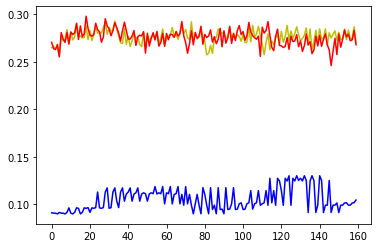

well CHIEF 33-28 4AH
(1, 8, 5, 18)
item[0] s (8, 5, 18)
here


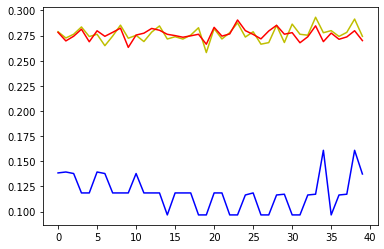

well CRAZY CAT 41-32 2AH
(3, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


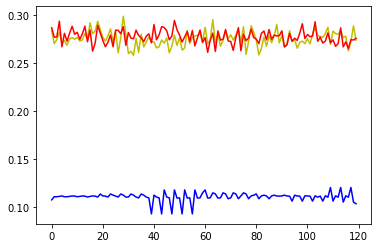

well CRAZY CAT 41-32 4AH
(9, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


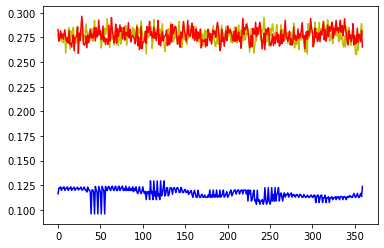

well DAVIS 36-5 (ALLOC-C) 3SA
(11, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


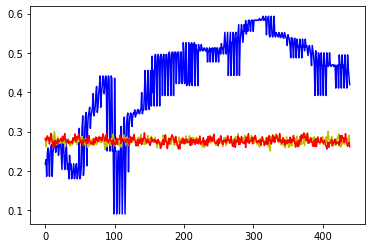

well DAVIS 36-5 (ALLOC-C) 3SB
(11, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


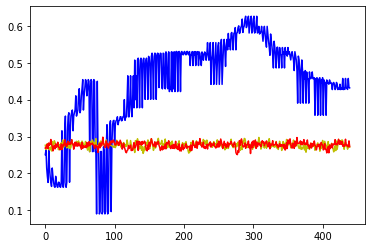

well DAVIS 36-5 (ALLOC-C) 3SS
(11, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


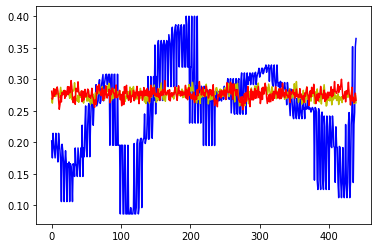

well DAVIS 36-5 (ALLOC-D) 4SB
(11, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


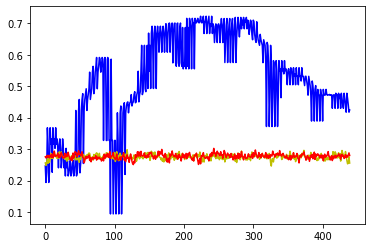

well DAVIS 36-5 (ALLOC-E) 5SA
(11, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


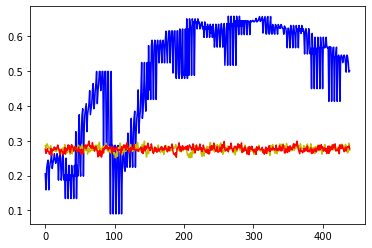

well DAVIS 36-5 (ALLOC-F) 6SB
(11, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


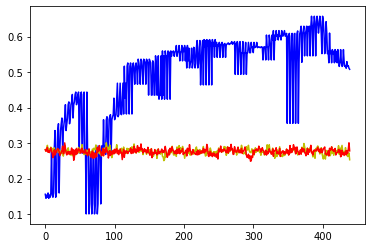

well DAVIS 36-5 (ALLOC-F) 6SS
(8, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


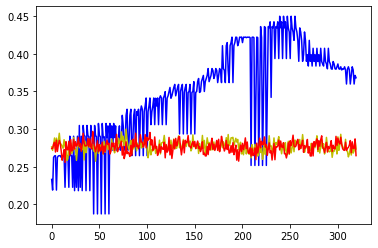

well DAVIS 36-5 (ALLOC-G) 7SA
(10, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


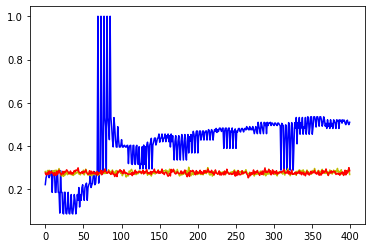

well DAVIS 36-5 (ALLOC-H) 8SB
(10, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


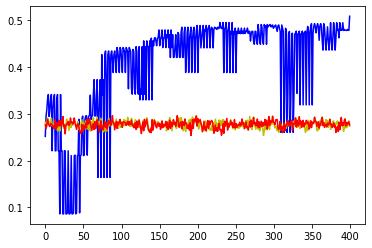

well DAVIS 36-5 (ALLOC-H) 8SS
(8, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


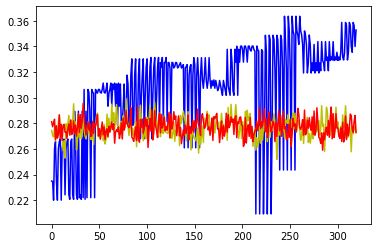

well DODGER 33-28 4AH
(9, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


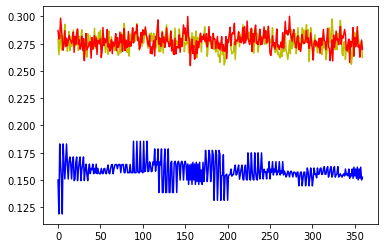

well FIRE EYES 47-38 4AH
(3, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


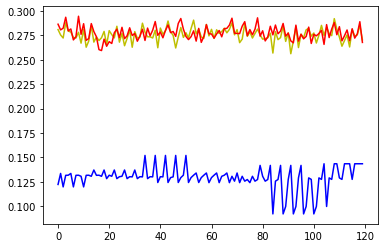

well GILBERT 25-24 (ALLOC-E) 5NM
(26, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


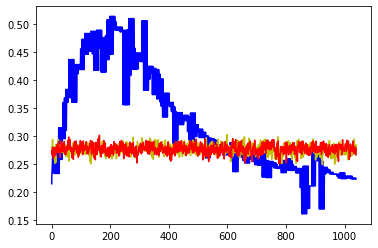

well GILBERT 25-24 (ALLOC-F) 6NA
(25, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


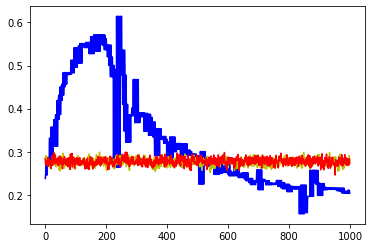

well GILBERT 25-24 (ALLOC-F) 6NB
(24, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


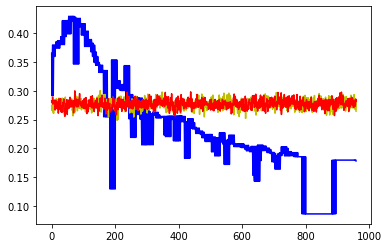

well GILBERT 25-24 (ALLOC-F) 6NS
(23, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


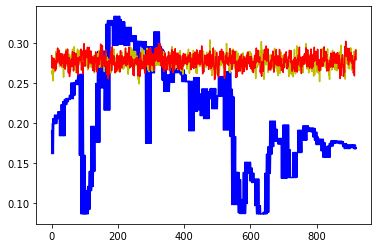

well GILBERT 25-24 (ALLOC-G) 7NB
(25, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


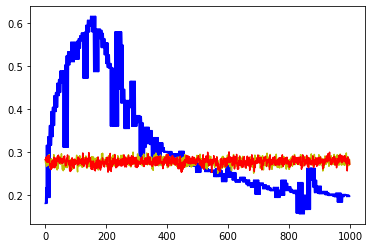

well GILBERT 25-24 (ALLOC-H) 8NA
(25, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


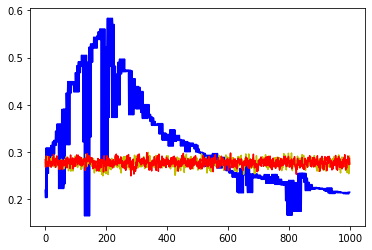

well GILBERT 25-24 (ALLOC-H) 8NB
(18, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


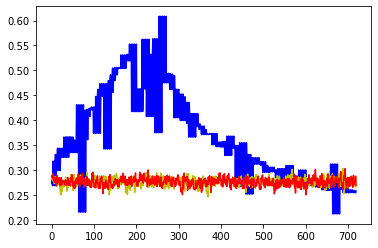

well GILBERT 25-24 (ALLOC-H) 8NS
(18, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


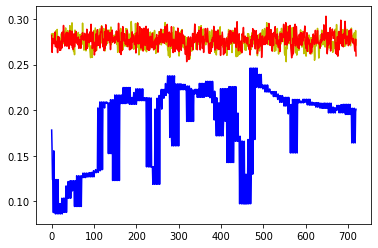

well MR. PHILLIPS 11-2 1SH
(8, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


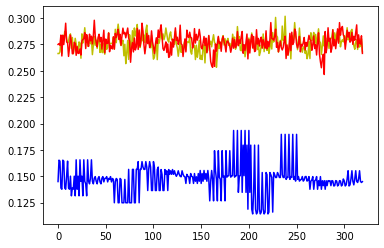

well PASSOW 25-24 (ALLOC-C) 3NA
(14, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


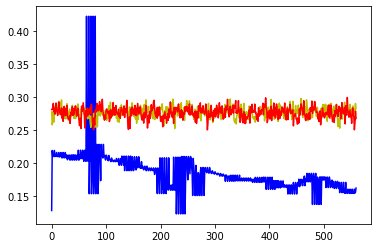

well PASSOW 25-24 (ALLOC-C) 3NB
(4, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


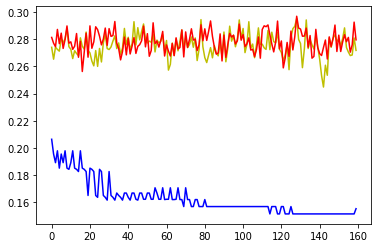

well RISING SUN 40-33 1AH
(9, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


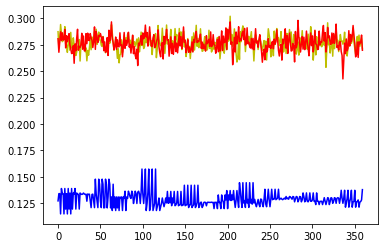

well SATNIN 37-36 1AH
(7, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


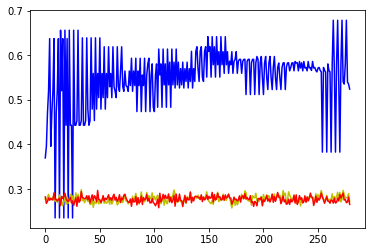

well SATNIN 37-36 1SH
(7, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


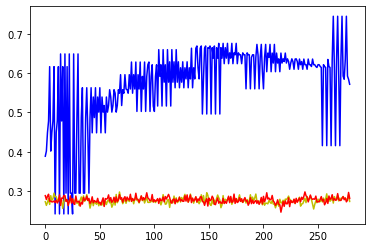

well SOUTHWEST 39-34 (ALLOC-A) 1NA
(5, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


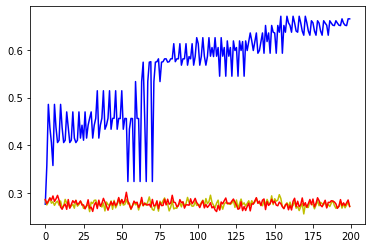

well SOUTHWEST 39-34 (ALLOC-A) 1NB
(5, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


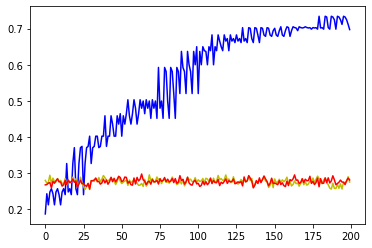

well SOUTHWEST 39-34 (ALLOC-A) 1NS
(2, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


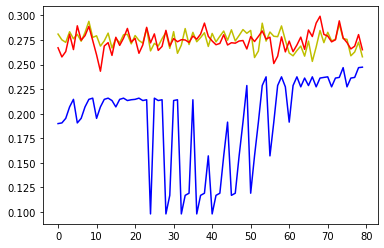

well SOUTHWEST 39-34 (ALLOC-B) 2NA
(5, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


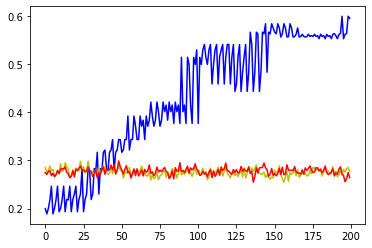

well SOUTHWEST 39-34 (ALLOC-C) 3NB
(5, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


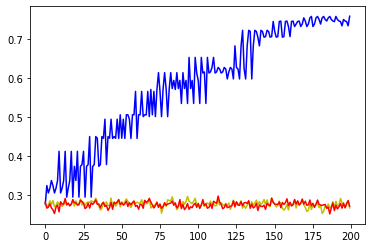

well SOUTHWEST 39-34 (ALLOC-C) 3NS
(3, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


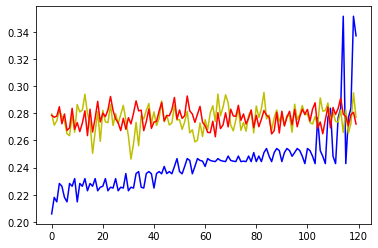

well THE COLONEL 25-36 2AH
(8, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


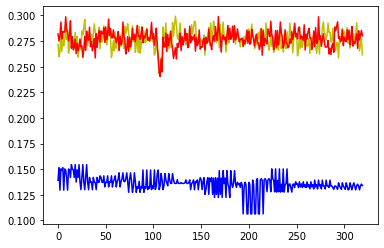

well THE COLONEL 25-36 2SH
(8, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


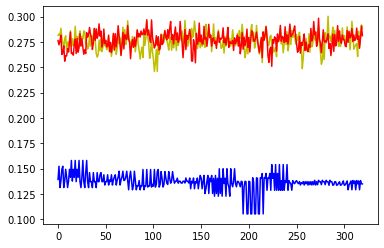

well THUMPER 14-23 1AH
(9, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


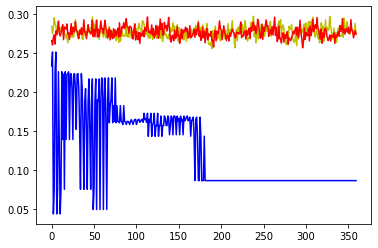

well TRENTINO 36-37 (ALLOC-C) 3SA
(18, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


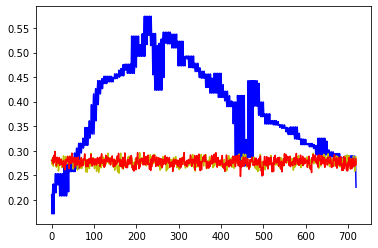

well TRENTINO 36-37 (ALLOC-C) 3SB
(19, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


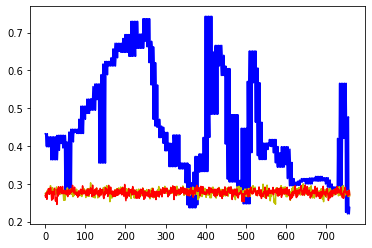

well TRENTINO 36-37 (ALLOC-C) 3SS
(18, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


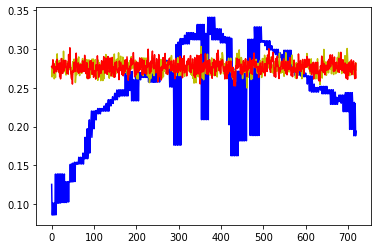

well TRENTINO 36-37 (ALLOC-D) 4SA
(14, 8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
item[0] s (8, 5, 18)
here


KeyboardInterrupt: ignored

In [115]:
def flatten(t):
    return [item for sublist in t for item in sublist]
    


for well in unique_wells:
  item_list = []
  preds_list = []
  changed_preds_list = []
  try:
    print("well", well)
    x, y = train_data_generator.get_batch_items(well)
    print(x.shape)
    for item in zip(x, y):
        print("item[0] s", item[0].shape)
        # item = train_data_generator[index]
        item_list.append(item[1].flatten())
        orig_pred = model(item[0], training=False)
        preds_list.append(orig_pred.numpy().flatten())

        # plt.plot(item[1].flatten())
        # plt.plot(orig_pred.numpy().flatten())
        # plt.show()

        mean, var, z = model.layers[0](item[0])
        # print("z.shape", z.shape)
        z = z.numpy()
        z[:, 0:2] *= 1.1 
        changed_preds = model.layers[1](z)
        changed_preds_list.append(changed_preds.numpy().flatten())

    print("here")
    res = flatten(item_list)
    res1 = flatten(preds_list)
    res2 = flatten(changed_preds_list)

    plt.plot(res, color='b')
    plt.plot(res1, color='y')
    plt.plot(res2, color='r')
    plt.show()


  except Exception as e:
    print(e)
    # continue


  # mean, var, z = model.layers[0](item[0])

  # print(item[1].shape)
  # plt.plot(item[1].flatten())
  # print(prediction.shape)
  # plt.plot(prediction.numpy().flatten())
  # plt.show()

In [ ]:
for l in model.layers:
  print(l)

In [ ]:
mean, var, z = model.layers[0](item[0])

In [ ]:
b = tf.math.sigmoid (z)
print(b)

tf.Tensor(
[[0.4643083  0.46459416 0.4654692  0.48302144 0.4644244  0.4645183
  0.535591  ]
 [0.46430913 0.46459293 0.46546933 0.48346227 0.46442583 0.4645186
  0.5355911 ]
 [0.464307   0.46459082 0.46547633 0.4834829  0.46442398 0.46451712
  0.53559035]
 [0.46430317 0.46458375 0.46546653 0.48337826 0.46442088 0.46451178
  0.5355931 ]
 [0.46430585 0.46458897 0.46546715 0.48337924 0.46442285 0.46451485
  0.535592  ]
 [0.46430913 0.46459416 0.46547067 0.4834635  0.46442583 0.46451822
  0.53559065]
 [0.46430784 0.46459332 0.46547237 0.48343942 0.46442562 0.46451843
  0.5355906 ]
 [0.46430975 0.46459395 0.46547562 0.48353216 0.4644266  0.46451867
  0.5355906 ]], shape=(8, 7), dtype=float32)


In [ ]:
item[0].shape

(8, 7, 18)